<a href="https://colab.research.google.com/github/gungdeari/Ageman/blob/main/Ageman.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## V1 with distributed data 80% train, 10% valid, 10% test

# **Install the Required Library and Packages**

In [ ]:
!python3 --version

Python 3.10.12


In [ ]:
!pip install -q tensorflow scikit-learn pillow matplotlib

### Import the Library and Packages

 After all the required library and packages installed, import the library and the packages. If there's an error, try to rerun the code

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import os
import tensorflow as tf
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization, UpSampling2D
from keras.optimizers import Adam
from PIL import Image

# **Preparing The Data**

Lorem ipsum

### Google Drive Mount

In [ ]:
from google.colab import drive, files
drive.mount('/content/drive')

Mounted at /content/drive


### Download Dataset

Lore Ipsum

In [ ]:
!gdown 1yrYOHdaXh80lpbfPOtAjIr24fPXyW2aM

Downloading...
From (original): https://drive.google.com/uc?id=1yrYOHdaXh80lpbfPOtAjIr24fPXyW2aM
From (redirected): https://drive.google.com/uc?id=1yrYOHdaXh80lpbfPOtAjIr24fPXyW2aM&confirm=t&uuid=45198ac9-55fd-43fe-acc2-3eca240d005e
To: /content/Dataset_ageman.zip
100% 362M/362M [00:06<00:00, 51.9MB/s]


In [ ]:
!gdown 1yI6NWKsjHoqK4KO3CVHo4JUdILmcRwz4

Downloading...
From: https://drive.google.com/uc?id=1yI6NWKsjHoqK4KO3CVHo4JUdILmcRwz4
To: /content/DataTest-ageman.zip
100% 8.02M/8.02M [00:00<00:00, 97.0MB/s]


### Extract The Data

Lorem Ipsum

In [ ]:
# Extract Dataset
!unzip /content/Dataset_ageman.zip

Archive:  /content/Dataset_ageman.zip
  inflating: Dataset-ageman/Kecak/valid/3.-Tari-Kecak-Bali-Selalu-Jadi-Incaran-Wisatawan-Manca-Negara.jpg  
  inflating: Dataset-ageman/Kecak/valid/uluwatu-2943964_960_720_mm1mp9.jpg  
  inflating: Dataset-ageman/Baris/valid/images-4-_jpg.rf.c9c8bf3270b3828f1863e6c192baa1ef.jpg  
  inflating: Dataset-ageman/Kecak/valid/664ecbffc3c3d.jpg  
  inflating: Dataset-ageman/Kecak/valid/jalurrempah.kemdikbudgoid.webp  
  inflating: Dataset-ageman/Kecak/valid/5-Rekomendasi-Tempat-Nonton-Tari-Kecak-di-Bali4-min.jpg  
  inflating: Dataset-ageman/Kecak/valid/kecak-dance-pura-dalem-temple-ubud-bali-indonesia-E6E5A4.jpg  
  inflating: Dataset-ageman/Baris/valid/IMG_2744.JPG  
  inflating: Dataset-ageman/Baris/valid/6__IMG_8828_Salah_satu_ciri_khas_dari_tari_baris_adalah_penutup_kepala_berbentuk_segitiga_dengan_barisan_kulit_kerang_yang_berjajar_vertikal_2_jpg.rf.c9a84679f8af83ab4d128ac0aa8051b7.jpg  
  inflating: Dataset-ageman/Kecak/valid/1c4da0873cfd31191454573

In [ ]:
!unzip /content/DataTest-ageman.zip

Archive:  /content/DataTest-ageman.zip
  inflating: Test-ageman/kecak2.jpeg  
  inflating: Test-ageman/baris2.jpeg  
  inflating: Test-ageman/baris1.jpeg  
  inflating: Test-ageman/jangertest1.jpg  
  inflating: Test-ageman/jangertest2.jpg  
  inflating: Test-ageman/barong2.jpeg  
  inflating: Test-ageman/kecak1.jpeg  
  inflating: Test-ageman/barong1.jpeg  
  inflating: Test-ageman/rejangsaritest1.png  
  inflating: Test-ageman/rejangsaritest2.png  


# **Exploratory Data Analysis**

Train set: 978 images
Validation set: 110 images
Test set: 110 images


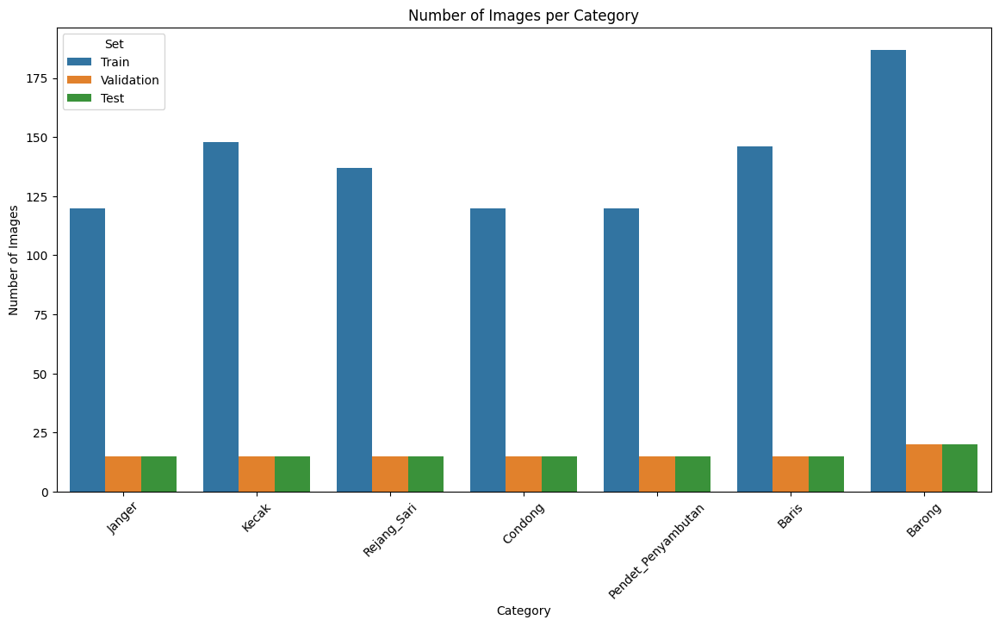

In [ ]:
dataset_dir = '/content/Dataset-ageman'

def count_images(folder):
    return sum([len(files) for r, d, files in os.walk(folder) if any(files)])

labels = os.listdir(dataset_dir)

# Count the number of images in each set for each label
train_label_counts = {label: count_images(os.path.join(dataset_dir, label, 'train')) if 'train' in os.listdir(os.path.join(dataset_dir, label)) else 0 for label in labels}
val_label_counts = {label: count_images(os.path.join(dataset_dir, label, 'valid')) if 'valid' in os.listdir(os.path.join(dataset_dir, label)) else 0 for label in labels}
test_label_counts = {label: count_images(os.path.join(dataset_dir, label, 'test')) if 'test' in os.listdir(os.path.join(dataset_dir, label)) else 0 for label in labels}

# Print total counts
train_count = sum(train_label_counts.values())
val_count = sum(val_label_counts.values())
test_count = sum(test_label_counts.values())

print(f'Train set: {train_count} images')
print(f'Validation set: {val_count} images')
print(f'Test set: {test_count} images')

# Combine all count into one DataFrame
data = {
    'Label': labels,
    'Train': [train_label_counts[label] for label in labels],
    'Validation': [val_label_counts[label] for label in labels],
    'Test': [test_label_counts[label] for label in labels]
}

df = pd.DataFrame(data)

# Visualization
plt.figure(figsize=(14, 7))
df_melted = df.melt(id_vars=['Label'], var_name='Set', value_name='Count')
sns.barplot(x='Label', y='Count', hue='Set', data=df_melted)
plt.title('Number of Images per Category')
plt.xlabel('Category')
plt.ylabel('Number of Images')
plt.xticks(rotation=45)
plt.show()

### Load the Dataset

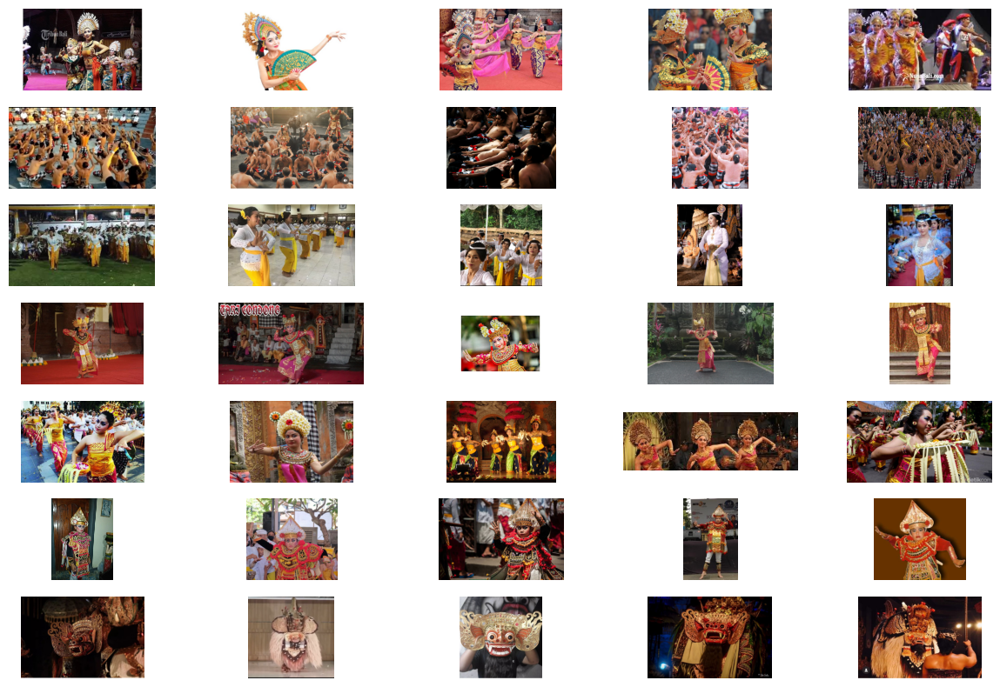

In [ ]:
# Show Data
def show_sample_images(dataset_dir, labels, samples_per_label=5):
    plt.figure(figsize=(15, 10))
    for i, label in enumerate(labels):
        folder = os.path.join(dataset_dir, label, 'train')
        images = os.listdir(folder)[:samples_per_label]
        for j, image in enumerate(images):
            img = Image.open(os.path.join(folder, image))
            plt.subplot(len(labels), samples_per_label, i * samples_per_label + j + 1)
            plt.imshow(img)
            plt.axis('off')
            if j == 0:
                plt.ylabel(label, size=100)
    plt.show()

show_sample_images(dataset_dir, labels)

### Data Augmentation

In [ ]:
# Image Data Generators
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=60,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    brightness_range=[0.8, 1.2],
    channel_shift_range=0.2,
    fill_mode='nearest'
)

val_test_datagen = ImageDataGenerator(rescale=1./255)

# Path to direktori dataset
dataset_dir = '/content/Dataset-ageman'

# Create directory paths for each set
train_dir = os.path.join(dataset_dir, 'train')
val_dir = os.path.join(dataset_dir, 'valid')
test_dir = os.path.join(dataset_dir, 'test')

# Create directories for train, valid, and test sets
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Move label subdirectories to the corresponding set directories
for label in os.listdir(dataset_dir):
    if os.path.isdir(os.path.join(dataset_dir, label)):
        if 'train' in os.listdir(os.path.join(dataset_dir, label)):
            os.rename(os.path.join(dataset_dir, label, 'train'), os.path.join(train_dir, label))
        if 'valid' in os.listdir(os.path.join(dataset_dir, label)):
            os.rename(os.path.join(dataset_dir, label, 'valid'), os.path.join(val_dir, label))
        if 'test' in os.listdir(os.path.join(dataset_dir, label)):
            os.rename(os.path.join(dataset_dir, label, 'test'), os.path.join(test_dir, label))

# Image Data Generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical'
)

val_generator = val_test_datagen.flow_from_directory(
    val_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical'
)

Found 926 images belonging to 7 classes.
Found 107 images belonging to 7 classes.


# **Build and Train Model**

### Creating CNN Model

In [ ]:
# Callback function
class Callback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        if(logs.get('accuracy')>0.90 and logs.get('val_accuracy')>0.90):
            print("\nTarget Reached")
            self.model.stop_training = True

# Build an CNN Model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(150, 150, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2)),
    Dropout(0.2),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(7, activation='softmax')
])

myCallback = Callback()

model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 150, 150, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 75, 75, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 37, 37, 64)        0         
 g2D)                                                            
                                                                 
 dropout (Dropout)           (None, 37, 37, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 37, 37, 128)       7

### Train the Model

In [ ]:
# Train the Model
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=100,
    validation_data=val_generator,
    validation_steps=len(val_generator),
    callbacks=myCallback
)

Epoch 1/100
29/29 [==============================] - 78s 3s/step - loss: 2.3177 - accuracy: 0.1760 - val_loss: 1.9435 - val_accuracy: 0.1776
Epoch 2/100
29/29 [==============================] - 81s 3s/step - loss: 1.8996 - accuracy: 0.2300 - val_loss: 1.8647 - val_accuracy: 0.2336
Epoch 3/100
29/29 [==============================] - 79s 3s/step - loss: 1.8459 - accuracy: 0.2851 - val_loss: 1.7608 - val_accuracy: 0.3271
Epoch 4/100
29/29 [==============================] - 76s 3s/step - loss: 1.7681 - accuracy: 0.3240 - val_loss: 1.7240 - val_accuracy: 0.3364
Epoch 5/100
29/29 [==============================] - 78s 3s/step - loss: 1.7382 - accuracy: 0.3521 - val_loss: 1.5500 - val_accuracy: 0.4486
Epoch 6/100
29/29 [==============================] - 86s 3s/step - loss: 1.6450 - accuracy: 0.3855 - val_loss: 1.4041 - val_accuracy: 0.4299
Epoch 7/100
29/29 [==============================] - 81s 3s/step - loss: 1.5812 - accuracy: 0.4082 - val_loss: 1.4737 - val_accuracy: 0.4206
Epoch 8/100
2

### Evaluation

4/4 [==============================] - 2s 472ms/step - loss: 0.5316 - accuracy: 0.8505
Test Accuracy: 85.05%


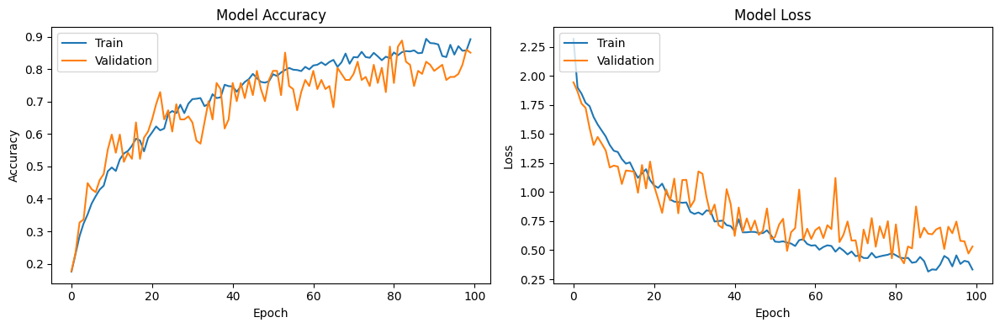

In [ ]:
# Model Evaluation
loss, accuracy = model.evaluate(val_generator)
print(f'Test Accuracy: {accuracy * 100:.2f}%')

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

# **Save Model**

In [ ]:
# Save model
model.save('ageman_model.h5')

# Convert to TFLite
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

# Save TFLite model
with open('ageman_model.tflite', 'wb') as f:
    f.write(tflite_model)

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


# **Test the Model**

### Testing with New Image

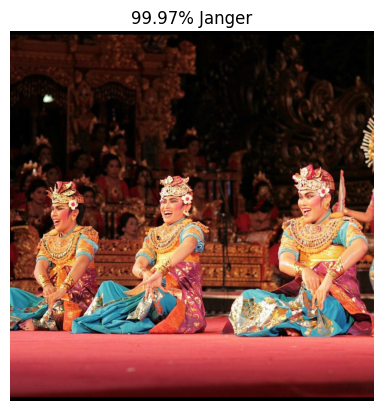

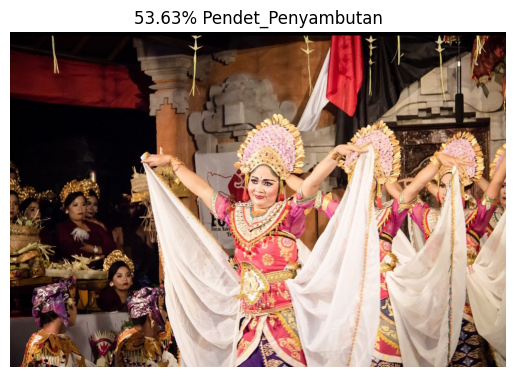

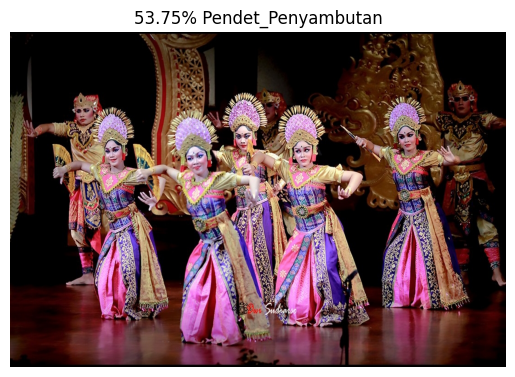

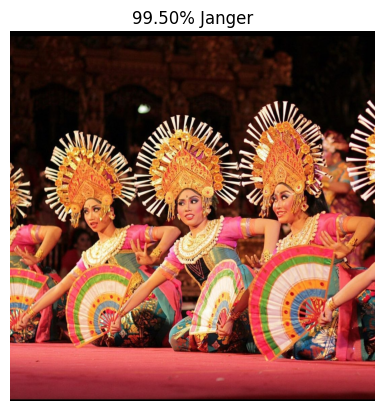

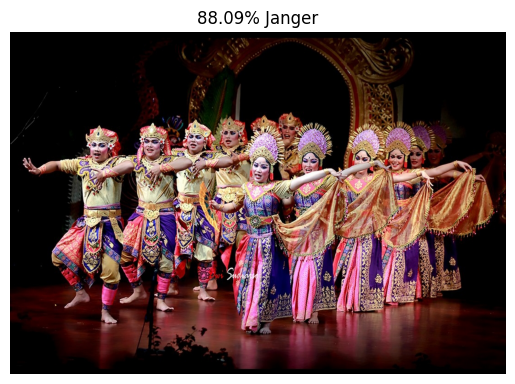

...

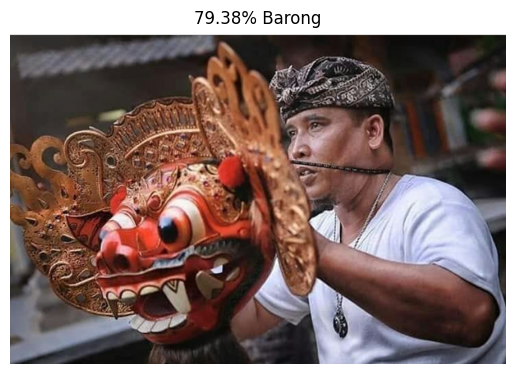

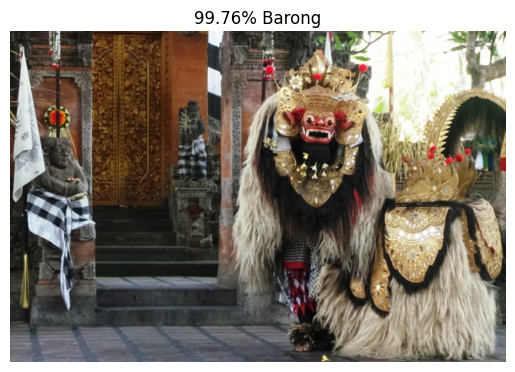

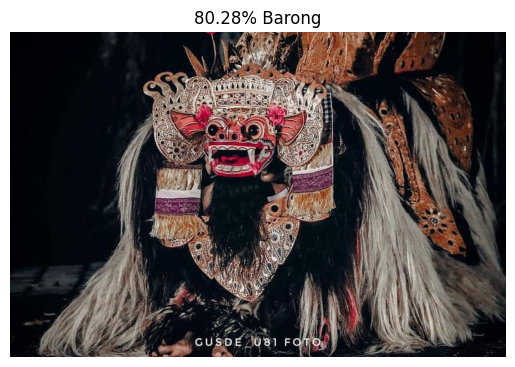

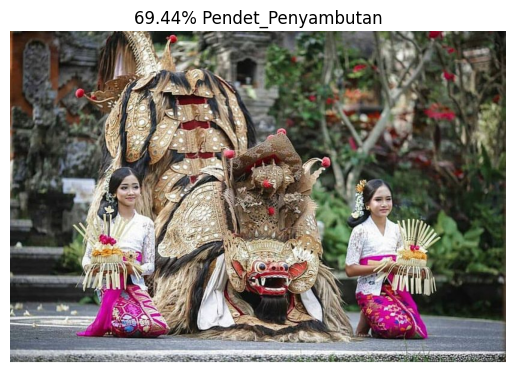

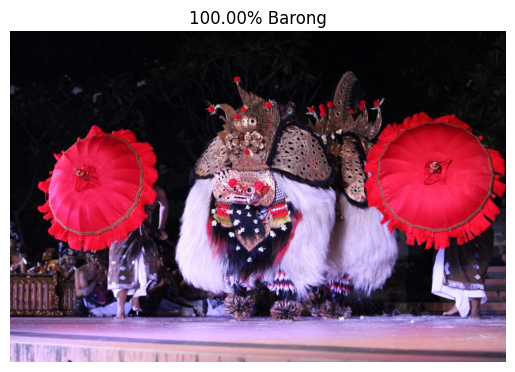

In [ ]:
interpreter = tf.lite.Interpreter(model_path='ageman_model.tflite')
interpreter.allocate_tensors()

input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

def preprocess_image(image_path):
    img = Image.open(image_path).resize((150, 150))
    img = np.array(img, dtype=np.float32)
    img = img / 255.0
    img = np.expand_dims(img, axis=0)
    return img

def display_prediction(image_path, prediction, labels):
    img = Image.open(image_path)
    predicted_label = labels[np.argmax(prediction)]
    confidence = np.max(prediction) * 100

    plt.imshow(img)
    plt.axis('off')
    plt.title(f'{confidence:.2f}% {predicted_label}')
    plt.show()

test_dir = '/content/Dataset-ageman/test'

test_images = []
for label in os.listdir(test_dir):
    label_dir = os.path.join(test_dir, label)
    if os.path.isdir(label_dir):
        for img_file in os.listdir(label_dir):
            if img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
                test_images.append(os.path.join(label_dir, img_file))

labels = ['Baris', 'Barong', 'Condong', 'Janger', 'Kecak', 'Pendet_Penyambutan', 'Rejang_Sari']


for image_path in test_images:
    try:
        input_data = preprocess_image(image_path)
        interpreter.set_tensor(input_details[0]['index'], input_data)
        interpreter.invoke()
        output_data = interpreter.get_tensor(output_details[0]['index'])

        # Show prediction
        display_prediction(image_path, output_data, labels)
    except Exception as e:
        print(f"Error processing {image_path}: {e}")

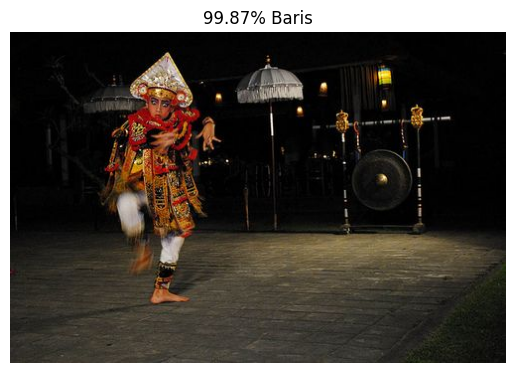

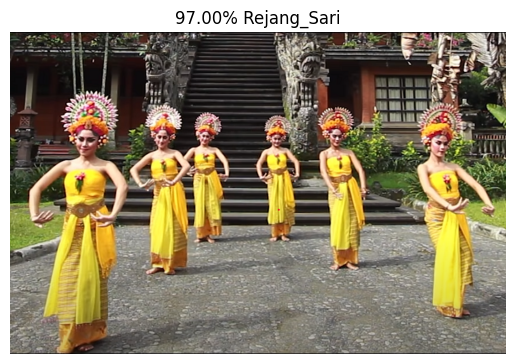

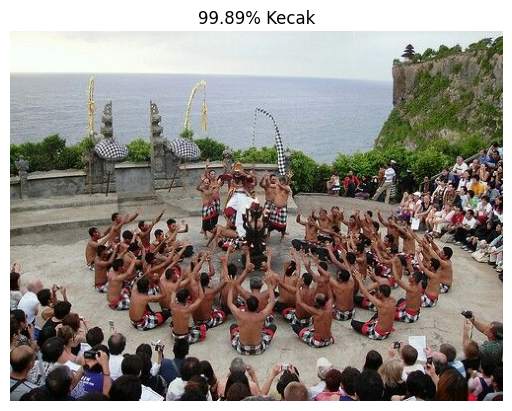

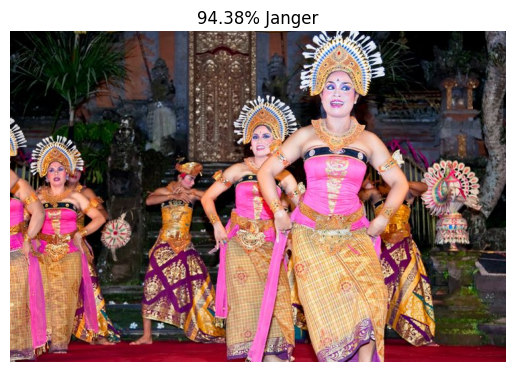

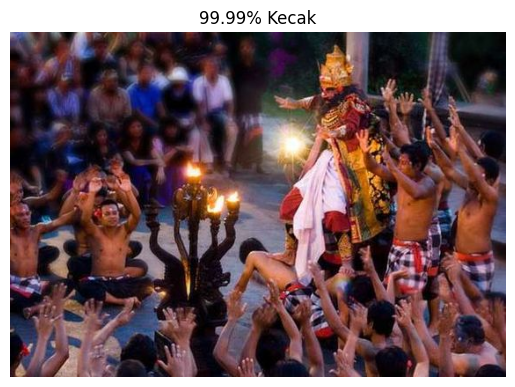

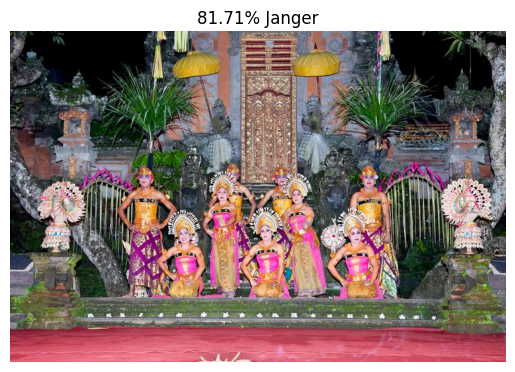

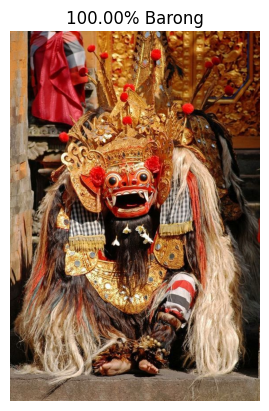

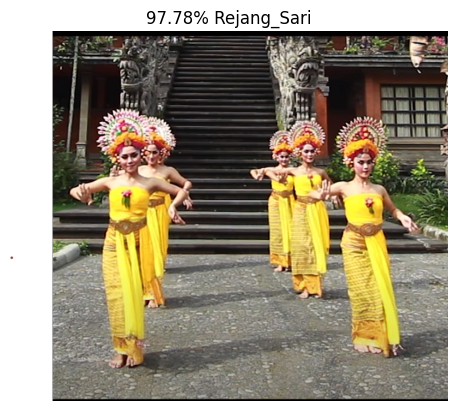

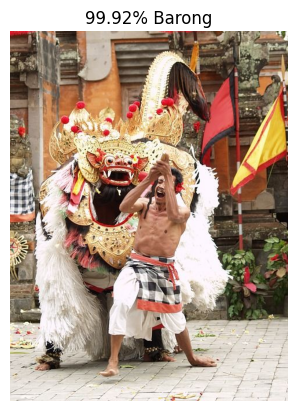

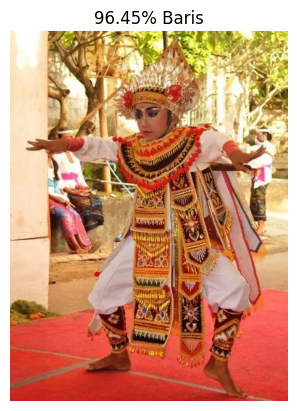

In [ ]:
import os
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt

# Load TFLite model and allocate tensors
interpreter = tf.lite.Interpreter(model_path='ageman_model.tflite')
interpreter.allocate_tensors()

input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

# Preprocess image
def preprocess_image(image_path):
    img = Image.open(image_path).resize((150, 150))
    img = img.convert('RGB')  # Ensure image is in RGB mode
    img = np.array(img, dtype=np.float32) / 255.0
    img = np.expand_dims(img, axis=0)
    return img

# Display prediction
def display_prediction(image_path, prediction, labels):
    img = Image.open(image_path)
    predicted_label = labels[np.argmax(prediction)]
    confidence = np.max(prediction) * 100

    plt.imshow(img)
    plt.axis('off')
    plt.title(f'{confidence:.2f}% {predicted_label}')
    plt.show()

# Directory containing test images
test_dir = '/content/Test-ageman'

# Get list of test images
test_images = [os.path.join(test_dir, img_file) for img_file in os.listdir(test_dir)
               if img_file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Define labels
labels = ['Baris', 'Barong', 'Condong', 'Janger', 'Kecak', 'Pendet_Penyambutan', 'Rejang_Sari']

# Run inference and display predictions
for image_path in test_images:
    try:
        input_data = preprocess_image(image_path)
        interpreter.set_tensor(input_details[0]['index'], input_data)
        interpreter.invoke()
        output_data = interpreter.get_tensor(output_details[0]['index'])

        # Show prediction
        display_prediction(image_path, output_data, labels)
    except Exception as e:
        print(f"Error processing {image_path}: {e}")